In [1]:
from keras.datasets import mnist
from keras.datasets import fashion_mnist

from sklearn.decomposition import PCA
from sklearn.neighbors import KernelDensity
from sklearn.model_selection import GridSearchCV

import random
import numpy as np
import matplotlib.pyplot as plt

In [2]:
# 加载MNIST数据集
(x1_train, y1_train), (x1_test, y1_test) = mnist.load_data()
x1_all = x1_train.reshape(60000, 784)
x1_t = x1_test.reshape(10000, 784)

In [3]:
# 加载Fashion-MNIST数据集
(x2_train, y2_train), (x2_test, y2_test) = fashion_mnist.load_data()
x2_all = x2_train.reshape(60000, 784)

### 实验1-1：替换 部分MNIST样本 为 MNIST其他样本 
### 实验1-1-1：N=5000，R = 0%， 5%， 10%， 20%， 40%， 80%
* 获取不同替换比例R对应的一维数据分布

In [4]:
# 随机抽取MNIST数据集中5000个元素得到实验原始数据x1
N = 5000
ind = random.sample(range(60000), N) # 原始数据与实验数据之间的映射
x1 = x1_all[ind]

In [5]:
"""获得R=0%时x1降维后的一维分布"""
pca_0 = PCA(n_components=1, whiten=False)
res_0 = pca_0.fit_transform(x1)

# 使用网格搜索交叉验证来优化带宽
params_0 = {'bandwidth': np.logspace(-1, 3, 40)}
grid_0 = GridSearchCV(KernelDensity(), params_0)
grid_0.fit(res_0)
print("best bandwidth 1d: {0}".format(grid_0.best_estimator_.bandwidth))

# 使用最佳估计器来计算核密度估计
kde_0 = grid_0.best_estimator_

best bandwidth 1d: 36.65241237079626


In [6]:
"""获得R=5%时x1降维后的一维分布"""
ind_r5m = random.sample(range(N), int(0.05*N))
x1_5m = x1
x1_5m[ind_r5m] = x1_t[:len(ind_r5m)]

pca_5m = PCA(n_components=1, whiten=False)
res_5m = pca_5m.fit_transform(x1_5m)

# 使用网格搜索交叉验证来优化带宽
params_5m = {'bandwidth': np.logspace(-1, 3, 40)}
grid_5m = GridSearchCV(KernelDensity(), params_5m)
grid_5m.fit(res_5m)
print("best bandwidth 1d: {0}".format(grid_5m.best_estimator_.bandwidth))

# 使用最佳估计器来计算核密度估计
kde_5m = grid_5m.best_estimator_

best bandwidth 1d: 36.65241237079626


In [7]:
"""获得R=10%时x1降维后的一维分布"""
ind_5m = list(filter(lambda x: x not in ind_r5m, range(5000))) # x1_5中原始元素对应x1中的索引
ind_a10m = random.sample(ind_5m, int(0.05*len(x1))) # x1_10相对x1_5新增被替换元素对应x1中的索引
ind_r10m = ind_r5m + ind_a10m # x1_10中所有被替换的元素对应x1中的索引
x1_10m = x1_5m
x1_10m[ind_a10m] = x1_t[len(ind_r5m):len(ind_r10m)]

pca_10m = PCA(n_components=1, whiten=False)
res_10m = pca_10m.fit_transform(x1_10m)

# 使用网格搜索交叉验证来优化带宽
params_10m = {'bandwidth': np.logspace(-1, 3, 40)}
grid_10m = GridSearchCV(KernelDensity(), params_10m)
grid_10m.fit(res_10m)
print("best bandwidth 1d: {0}".format(grid_10m.best_estimator_.bandwidth))

# 使用最佳估计器来计算核密度估计
kde_10m = grid_10m.best_estimator_

best bandwidth 1d: 36.65241237079626


In [8]:
"""获得R=20%时x1降维后的一维分布"""
ind_10m = list(filter(lambda x: x not in ind_r10m, range(5000))) # x1_10中原始元素对应x1中的索引
ind_a20m = random.sample(ind_10m, int(0.1*len(x1))) # x1_20相对x1_10新增被替换元素对应x1中的索引
ind_r20m = ind_r10m + ind_a20m # x1_20中所有被替换的元素对应x1中的索引
x1_20m = x1_10m
x1_20m[ind_a20m] = x1_t[len(ind_r10m):len(ind_r20m)]

pca_20m = PCA(n_components=1, whiten=False)
res_20m = pca_20m.fit_transform(x1_20m)

# 使用网格搜索交叉验证来优化带宽
params_20m = {'bandwidth': np.logspace(-1, 3, 40)}
grid_20m = GridSearchCV(KernelDensity(), params_20m)
grid_20m.fit(res_20m)
print("best bandwidth 1d: {0}".format(grid_20m.best_estimator_.bandwidth))

# 使用最佳估计器来计算核密度估计
kde_20m = grid_20m.best_estimator_

best bandwidth 1d: 36.65241237079626


In [9]:
"""获得R=40%时x1降维后的一维分布"""
ind_20m = list(filter(lambda x: x not in ind_r20m, range(5000))) # x1_20中原始元素对应x1中的索引
ind_a40m = random.sample(ind_20m, int(0.2*len(x1))) # x1_40相对x1_20新增被替换元素对应x1中的索引
ind_r40m = ind_r20m + ind_a40m # x1_40中所有被替换的元素对应x1中的索引
x1_40m = x1_20m
x1_40m[ind_a40m] = x1_t[len(ind_r20m):len(ind_r40m)]

pca_40m = PCA(n_components=1, whiten=False)
res_40m = pca_40m.fit_transform(x1_40m)

# 使用网格搜索交叉验证来优化带宽
params_40m = {'bandwidth': np.logspace(-1, 3, 40)}
grid_40m = GridSearchCV(KernelDensity(), params_40m)
grid_40m.fit(res_40m)
print("best bandwidth 1d: {0}".format(grid_40m.best_estimator_.bandwidth))

# 使用最佳估计器来计算核密度估计
kde_40m = grid_40m.best_estimator_

best bandwidth 1d: 36.65241237079626


In [10]:
"""获得R=80%时x1降维后的一维分布"""
ind_40m = list(filter(lambda x: x not in ind_r40m, range(5000))) # x1_20中原始元素对应x1中的索引
ind_a80m = random.sample(ind_40m, int(0.4*len(x1))) # x1_40相对x1_20新增被替换元素对应x1中的索引
ind_r80m = ind_r40m + ind_a80m # x1_40中所有被替换的元素对应x1中的索引
x1_80m = x1_40m
x1_80m[ind_a80m] = x1_t[len(ind_r40m):len(ind_r80m)]

pca_80m = PCA(n_components=1, whiten=False)
res_80m = pca_80m.fit_transform(x1_80m)

# 使用网格搜索交叉验证来优化带宽
params_80m = {'bandwidth': np.logspace(-1, 3, 40)}
grid_80m = GridSearchCV(KernelDensity(), params_80m)
grid_80m.fit(res_80m)
print("best bandwidth 1d: {0}".format(grid_80m.best_estimator_.bandwidth))

# 使用最佳估计器来计算核密度估计
kde_80m = grid_80m.best_estimator_

best bandwidth 1d: 36.65241237079626


#### a) 不同一维分布的可视化对比

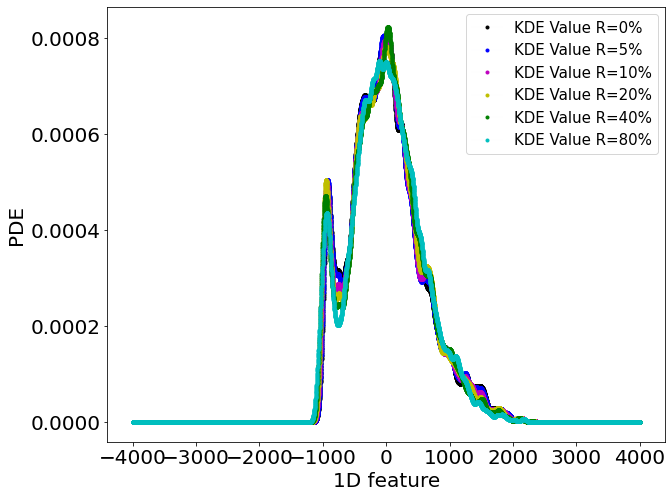

In [11]:
xplot = np.linspace(-4000, 4000, 8000).reshape(-1,1)
dens_0 = kde_0.score_samples(xplot)  # 返回的是点对应概率密度的log值，需要使用exp求指数还原
dens_5m = kde_5m.score_samples(xplot)
dens_10m = kde_10m.score_samples(xplot)
dens_20m = kde_20m.score_samples(xplot)
dens_40m = kde_40m.score_samples(xplot)
dens_80m = kde_80m.score_samples(xplot)

plt.figure(figsize = (10, 8))  # 设置画布大小
plt.plot(xplot, np.exp(dens_0), marker='.', linewidth=0.01, c="k", label='KDE Value R=0%')
plt.plot(xplot, np.exp(dens_5m), marker='.', linewidth=0.01, c="b", label='KDE Value R=5%')
plt.plot(xplot, np.exp(dens_10m), marker='.', linewidth=0.01, c="m", label='KDE Value R=10%')
plt.plot(xplot, np.exp(dens_20m), marker='.', linewidth=0.01, c="y", label='KDE Value R=20%')
plt.plot(xplot, np.exp(dens_40m), marker='.', linewidth=0.01, c="g", label='KDE Value R=40%')
plt.plot(xplot, np.exp(dens_80m), marker='.', linewidth=0.01, c="c", label='KDE Value R=80%')
plt.tick_params(labelsize = 20)  # 设置坐标刻度值的大小
font = {'size': 20}  # 设置横纵坐标的名称以及对应字体格式、大小
plt.xlabel('1D feature', font)
plt.ylabel('PDE', font)
plt.legend(fontsize = 15)  # 显示图例,设置图例字体大小
plt.show()

#### b) 1D特征区间\[-1000, -500\]对应样本数据的对比（R = 0% vs 5%）

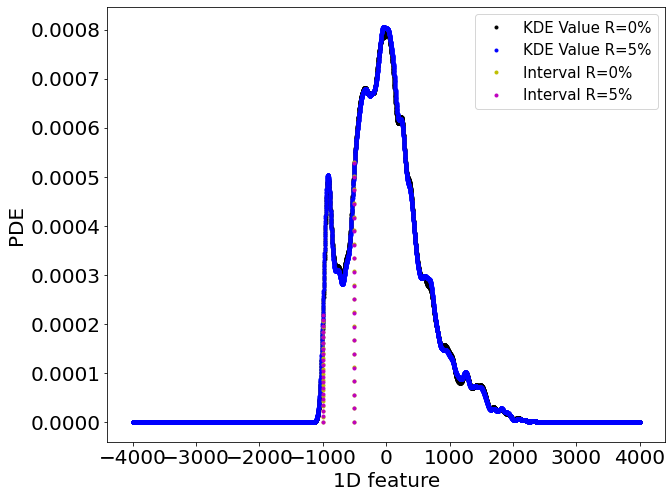

In [12]:
"""可视化所选取的区间"""
plt.figure(figsize = (10, 8))  # 设置画布大小
plt.plot(xplot, np.exp(dens_0), marker='.', linewidth=1e-10, c="k", label='KDE Value R=0%')
plt.plot(xplot, np.exp(dens_5m), marker='.', linewidth=1e-10, c="b", label='KDE Value R=5%')

px_0 = [-1000] * 20 + [-500] * 20
py_0 = list(np.linspace(0, np.exp(kde_0.score_samples([[-1000]])[0]), 20)) + list(np.linspace(0, np.exp(kde_0.score_samples([[-500]])[0]), 20))

px_5m = [-1000] * 20 + [-500] * 20
py_5m = list(np.linspace(0, np.exp(kde_5m.score_samples([[-1000]])[0]), 20)) + list(np.linspace(0, np.exp(kde_5m.score_samples([[-500]])[0]), 20))

plt.plot(px_0, py_0, marker='.', linewidth=1e-5, c="y", label='Interval R=0%')
plt.plot(px_5m, py_5m, marker='.', linewidth=1e-5, c="m", label='Interval R=5%')

plt.tick_params(labelsize = 20)  # 设置坐标刻度值的大小
font = {'size': 20}  # 设置横纵坐标的名称以及对应字体格式、大小
plt.xlabel('1D feature', font)
plt.ylabel('PDE', font)
plt.legend(fontsize = 15)  # 显示图例,设置图例字体大小
plt.show()

In [13]:
"""R=0%时[-1000, -500]对应的样本类别统计"""
ind_int = np.array([i for (i,x) in enumerate(res_0.flatten().tolist()) if -1000 <= x < -500])
ind_int_m = np.array(ind)[ind_int]
num_int_m = ind_int_m.shape[0]
label_int_m = y1_train[ind_int_m]
num_int_m0 = label_int_m.tolist().count(0)
num_int_m1 = label_int_m.tolist().count(1)
num_int_m2 = label_int_m.tolist().count(2)
num_int_m3 = label_int_m.tolist().count(3)
num_int_m4 = label_int_m.tolist().count(4)
num_int_m5 = label_int_m.tolist().count(5)
num_int_m6 = label_int_m.tolist().count(6)
num_int_m7 = label_int_m.tolist().count(7)
num_int_m8 = label_int_m.tolist().count(8)
num_int_m9 = label_int_m.tolist().count(9)

In [14]:
"""R=5%时被替换掉的[-1000, -500]中样本对应的样本类别统计"""
ind_int_r5 = np.array([i for (i,x) in enumerate(res_0[ind_r5m].flatten().tolist()) if -1000 <= x < -500])
ind_int_r5m = np.array(ind)[ind_int_r5]
num_int_r5 = ind_int_r5m.shape[0]
label_int_r5 = y1_train[ind_int_r5m]
num_int_r5m0 = label_int_r5.tolist().count(0)
num_int_r5m1 = label_int_r5.tolist().count(1)
num_int_r5m2 = label_int_r5.tolist().count(2)
num_int_r5m3 = label_int_r5.tolist().count(3)
num_int_r5m4 = label_int_r5.tolist().count(4)
num_int_r5m5 = label_int_r5.tolist().count(5)
num_int_r5m6 = label_int_r5.tolist().count(6)
num_int_r5m7 = label_int_r5.tolist().count(7)
num_int_r5m8 = label_int_r5.tolist().count(8)
num_int_r5m9 = label_int_r5.tolist().count(9)

In [15]:
"""R=5%时新添的[-1000, -500]中样本对应的样本类别统计"""
ind_int_r5mt = np.array([i for (i,x) in enumerate(res_5m[ind_r5m].flatten().tolist()) if -1000 <= x < -500])
ind_int_r5mtm = np.array(ind)[ind_int_r5mt]
num_int_r5mt = ind_int_r5mtm.shape[0]
label_int_r5mt = y1_train[ind_int_r5mtm]
num_int_r5mt0 = label_int_r5mt.tolist().count(0)
num_int_r5mt1 = label_int_r5mt.tolist().count(1)
num_int_r5mt2 = label_int_r5mt.tolist().count(2)
num_int_r5mt3 = label_int_r5mt.tolist().count(3)
num_int_r5mt4 = label_int_r5mt.tolist().count(4)
num_int_r5mt5 = label_int_r5mt.tolist().count(5)
num_int_r5mt6 = label_int_r5mt.tolist().count(6)
num_int_r5mt7 = label_int_r5mt.tolist().count(7)
num_int_r5mt8 = label_int_r5mt.tolist().count(8)
num_int_r5mt9 = label_int_r5mt.tolist().count(9)

### 实验1-1-2：实验1-1-2：R = 0%，N = 2000，3000，4000，5000，6000，7000

In [16]:
N_2000 = 2000
x1_2000 = x1_all[random.sample(range(60000), N_2000)]

"""获得R=0%时x1降维后的一维分布"""
pca_2000 = PCA(n_components=1, whiten=False)
res_2000 = pca_2000.fit_transform(x1_2000)

# 使用网格搜索交叉验证来优化带宽
params_2000 = {'bandwidth': np.logspace(-1, 3, 40)}
grid_2000 = GridSearchCV(KernelDensity(), params_2000)
grid_2000.fit(res_2000)
print("best bandwidth 1d: {0}".format(grid_2000.best_estimator_.bandwidth))

# 使用最佳估计器来计算核密度估计
kde_2000 = grid_2000.best_estimator_

best bandwidth 1d: 58.780160722749116


In [17]:
N_3000 = 3000
x1_3000 = x1_all[random.sample(range(60000), N_3000)]

"""获得R=0%时x1降维后的一维分布"""
pca_3000 = PCA(n_components=1, whiten=False)
res_3000 = pca_3000.fit_transform(x1_3000)

# 使用网格搜索交叉验证来优化带宽
params_3000 = {'bandwidth': np.logspace(-1, 3, 40)}
grid_3000 = GridSearchCV(KernelDensity(), params_3000)
grid_3000.fit(res_3000)
print("best bandwidth 1d: {0}".format(grid_3000.best_estimator_.bandwidth))

# 使用最佳估计器来计算核密度估计
kde_3000 = grid_3000.best_estimator_

best bandwidth 1d: 36.65241237079626


In [18]:
N_4000 = 4000
x1_4000 = x1_all[random.sample(range(60000), N_4000)]

"""获得R=0%时x1降维后的一维分布"""
pca_4000 = PCA(n_components=1, whiten=False)
res_4000 = pca_4000.fit_transform(x1_4000)

# 使用网格搜索交叉验证来优化带宽
params_4000 = {'bandwidth': np.logspace(-1, 3, 40)}
grid_4000 = GridSearchCV(KernelDensity(), params_4000)
grid_4000.fit(res_4000)
print("best bandwidth 1d: {0}".format(grid_4000.best_estimator_.bandwidth))

# 使用最佳估计器来计算核密度估计
kde_4000 = grid_4000.best_estimator_

best bandwidth 1d: 46.41588833612777


In [19]:
N_6000 = 6000
x1_6000 = x1_all[random.sample(range(60000), N_6000)]

"""获得R=0%时x1降维后的一维分布"""
pca_6000 = PCA(n_components=1, whiten=False)
res_6000 = pca_6000.fit_transform(x1_6000)

# 使用网格搜索交叉验证来优化带宽
params_6000 = {'bandwidth': np.logspace(-1, 3, 40)}
grid_6000 = GridSearchCV(KernelDensity(), params_6000)
grid_6000.fit(res_6000)
print("best bandwidth 1d: {0}".format(grid_6000.best_estimator_.bandwidth))

# 使用最佳估计器来计算核密度估计
kde_6000 = grid_6000.best_estimator_

best bandwidth 1d: 46.41588833612777


In [20]:
N_7000 = 7000
x1_7000 = x1_all[random.sample(range(60000), N_7000)]

"""获得R=0%时x1降维后的一维分布"""
pca_7000 = PCA(n_components=1, whiten=False)
res_7000 = pca_7000.fit_transform(x1_7000)

# 使用网格搜索交叉验证来优化带宽
params_7000 = {'bandwidth': np.logspace(-1, 3, 40)}
grid_7000 = GridSearchCV(KernelDensity(), params_7000)
grid_7000.fit(res_7000)
print("best bandwidth 1d: {0}".format(grid_7000.best_estimator_.bandwidth))

# 使用最佳估计器来计算核密度估计
kde_7000 = grid_7000.best_estimator_

best bandwidth 1d: 36.65241237079626


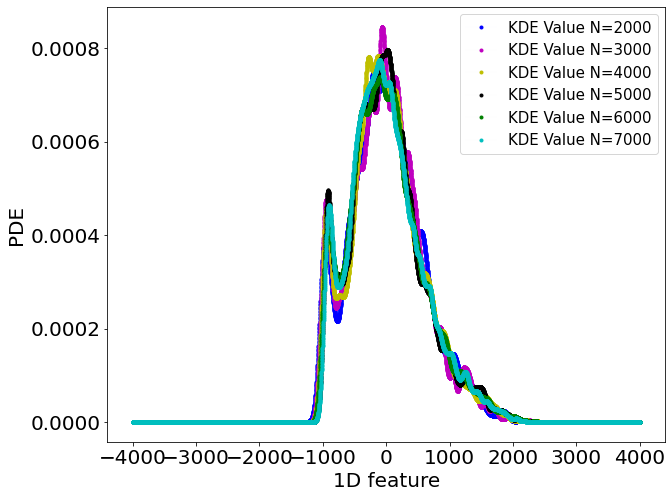

In [21]:
xplot = np.linspace(-4000, 4000, 8000).reshape(-1,1)
dens_2000 = kde_2000.score_samples(xplot)  # 返回的是点对应概率密度的log值，需要使用exp求指数还原
dens_3000 = kde_3000.score_samples(xplot)
dens_4000 = kde_4000.score_samples(xplot)
dens_0 = kde_0.score_samples(xplot)
dens_6000 = kde_6000.score_samples(xplot)
dens_7000 = kde_7000.score_samples(xplot)

plt.figure(figsize = (10, 8))  # 设置画布大小
plt.plot(xplot, np.exp(dens_2000), marker='.', linewidth=0.01, c="b", label='KDE Value N=2000')
plt.plot(xplot, np.exp(dens_3000), marker='.', linewidth=0.01, c="m", label='KDE Value N=3000')
plt.plot(xplot, np.exp(dens_4000), marker='.', linewidth=0.01, c="y", label='KDE Value N=4000')
plt.plot(xplot, np.exp(dens_0), marker='.', linewidth=0.01, c="k", label='KDE Value N=5000')
plt.plot(xplot, np.exp(dens_6000), marker='.', linewidth=0.01, c="g", label='KDE Value N=6000')
plt.plot(xplot, np.exp(dens_7000), marker='.', linewidth=0.01, c="c", label='KDE Value N=7000')
plt.tick_params(labelsize = 20)  # 设置坐标刻度值的大小
font = {'size': 20}  # 设置横纵坐标的名称以及对应字体格式、大小
plt.xlabel('1D feature', font)
plt.ylabel('PDE', font)
plt.legend(fontsize = 15)  # 显示图例,设置图例字体大小
plt.show()

### 实验1-2：替换 部分MNIST样本 为 Fashion-MNIST样本
### 实验1-2-1：N=5000，R = 0%， 5%， 10%， 20%， 40%， 80%
* 获取不同替换比例R对应的一维数据分布

In [22]:
"""获得R=5%时x1降维后的一维分布"""
# ind_r5f = random.sample(range(N), int(0.05*N))
x1_5f = x1
x1_5f[ind_r5m] = x2_all[:len(ind_r5m)]

pca_5f = PCA(n_components=1, whiten=False)
res_5f = pca_5f.fit_transform(x1_5f)

# 使用网格搜索交叉验证来优化带宽
params_5f = {'bandwidth': np.logspace(-1, 3, 40)}
grid_5f = GridSearchCV(KernelDensity(), params_5f)
grid_5f.fit(res_5f)
print("best bandwidth 1d: {0}".format(grid_5f.best_estimator_.bandwidth))

# 使用最佳估计器来计算核密度估计
kde_5f = grid_5f.best_estimator_

best bandwidth 1d: 46.41588833612777


In [23]:
"""获得R=10%时x1降维后的一维分布"""
# ind_5f = list(filter(lambda x: x not in ind_r5f, range(5000))) # x1_5中原始元素对应x1中的索引
# ind_a10f = random.sample(ind_5f, int(0.05*len(x1))) # x1_10相对x1_5新增被替换元素对应x1中的索引
# ind_r10f = ind_r5f + ind_a10f # x1_10中所有被替换的元素对应x1中的索引
x1_10f = x1_5f
x1_10f[ind_a10m] = x2_all[len(ind_r5m):len(ind_r10m)]

pca_10f = PCA(n_components=1, whiten=False)
res_10f = pca_10f.fit_transform(x1_10f)

# 使用网格搜索交叉验证来优化带宽
params_10f = {'bandwidth': np.logspace(-1, 3, 40)}
grid_10f = GridSearchCV(KernelDensity(), params_10f)
grid_10f.fit(res_10f)
print("best bandwidth 1d: {0}".format(grid_10f.best_estimator_.bandwidth))

# 使用最佳估计器来计算核密度估计
kde_10f = grid_10f.best_estimator_

best bandwidth 1d: 46.41588833612777


In [24]:
"""获得R=20%时x1降维后的一维分布"""
# ind_10f = list(filter(lambda x: x not in ind_r10f, range(5000))) # x1_10中原始元素对应x1中的索引
# ind_a20f = random.sample(ind_10f, int(0.1*len(x1))) # x1_20相对x1_10新增被替换元素对应x1中的索引
# ind_r20f = ind_r10f + ind_a20f # x1_20中所有被替换的元素对应x1中的索引
x1_20f = x1_10f
x1_20f[ind_a20m] = x2_all[len(ind_r10m):len(ind_r20m)]

pca_20f = PCA(n_components=1, whiten=False)
res_20f = pca_20f.fit_transform(x1_20f)

# 使用网格搜索交叉验证来优化带宽
params_20f = {'bandwidth': np.logspace(-1, 3, 40)}
grid_20f = GridSearchCV(KernelDensity(), params_20f)
grid_20f.fit(res_20f)
print("best bandwidth 1d: {0}".format(grid_20f.best_estimator_.bandwidth))

# 使用最佳估计器来计算核密度估计
kde_20f = grid_20f.best_estimator_

best bandwidth 1d: 46.41588833612777


In [25]:
"""获得R=40%时x1降维后的一维分布"""
# ind_20f = list(filter(lambda x: x not in ind_r20f, range(5000))) # x1_20中原始元素对应x1中的索引
# ind_a40f = random.sample(ind_20f, int(0.2*len(x1))) # x1_40相对x1_20新增被替换元素对应x1中的索引
# ind_r40f = ind_r20f + ind_a40f # x1_40中所有被替换的元素对应x1中的索引
x1_40f = x1_20f
x1_40f[ind_a40m] = x2_all[len(ind_r20m):len(ind_r40m)]

pca_40f = PCA(n_components=1, whiten=False)
res_40f = pca_40f.fit_transform(x1_40f)

# 使用网格搜索交叉验证来优化带宽
params_40f = {'bandwidth': np.logspace(-1, 3, 40)}
grid_40f = GridSearchCV(KernelDensity(), params_40f)
grid_40f.fit(res_40f)
print("best bandwidth 1d: {0}".format(grid_40f.best_estimator_.bandwidth))

# 使用最佳估计器来计算核密度估计
kde_40f = grid_40f.best_estimator_

best bandwidth 1d: 58.780160722749116


In [26]:
"""获得R=80%时x1降维后的一维分布"""
# ind_40f = list(filter(lambda x: x not in ind_r40f, range(5000))) # x1_20中原始元素对应x1中的索引
# ind_a80f = random.sample(ind_40f, int(0.4*len(x1))) # x1_40相对x1_20新增被替换元素对应x1中的索引
# ind_r80f = ind_r40f + ind_a80f # x1_40中所有被替换的元素对应x1中的索引
x1_80f = x1_40f
x1_80f[ind_a80m] = x2_all[len(ind_r40m):len(ind_r80m)]

pca_80f = PCA(n_components=1, whiten=False)
res_80f = pca_80f.fit_transform(x1_80f)

# 使用网格搜索交叉验证来优化带宽
params_80f = {'bandwidth': np.logspace(-1, 3, 40)}
grid_80f = GridSearchCV(KernelDensity(), params_80f)
grid_80f.fit(res_80f)
print("best bandwidth 1d: {0}".format(grid_80f.best_estimator_.bandwidth))

# 使用最佳估计器来计算核密度估计
kde_80f = grid_80f.best_estimator_

best bandwidth 1d: 58.780160722749116


#### a) 不同一维分布的可视化对比

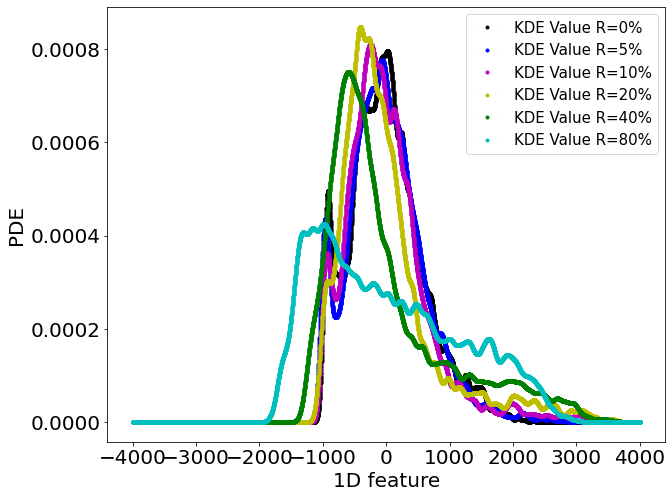

In [27]:
xplot = np.linspace(-4000, 4000, 8000).reshape(-1,1)
dens_0 = kde_0.score_samples(xplot)  # 返回的是点对应概率密度的log值，需要使用exp求指数还原
dens_5f = kde_5f.score_samples(xplot)
dens_10f = kde_10f.score_samples(xplot)
dens_20f = kde_20f.score_samples(xplot)
dens_40f = kde_40f.score_samples(xplot)
dens_80f = kde_80f.score_samples(xplot)

plt.figure(figsize = (10, 8))  # 设置画布大小
plt.plot(xplot, np.exp(dens_0), marker='.', linewidth=0.01, c="k", label='KDE Value R=0%')
plt.plot(xplot, np.exp(dens_5f), marker='.', linewidth=0.01, c="b", label='KDE Value R=5%')
plt.plot(xplot, np.exp(dens_10f), marker='.', linewidth=0.01, c="m", label='KDE Value R=10%')
plt.plot(xplot, np.exp(dens_20f), marker='.', linewidth=0.01, c="y", label='KDE Value R=20%')
plt.plot(xplot, np.exp(dens_40f), marker='.', linewidth=0.01, c="g", label='KDE Value R=40%')
plt.plot(xplot, np.exp(dens_80f), marker='.', linewidth=0.01, c="c", label='KDE Value R=80%')
plt.tick_params(labelsize = 20)  # 设置坐标刻度值的大小
font = {'size': 20}  # 设置横纵坐标的名称以及对应字体格式、大小
plt.xlabel('1D feature', font)
plt.ylabel('PDE', font)
plt.legend(fontsize = 15)  # 显示图例,设置图例字体大小
plt.show()

#### b) 1D特征区间\[-1000, -500\]对应样本数据的对比（R = 0% vs 5%）

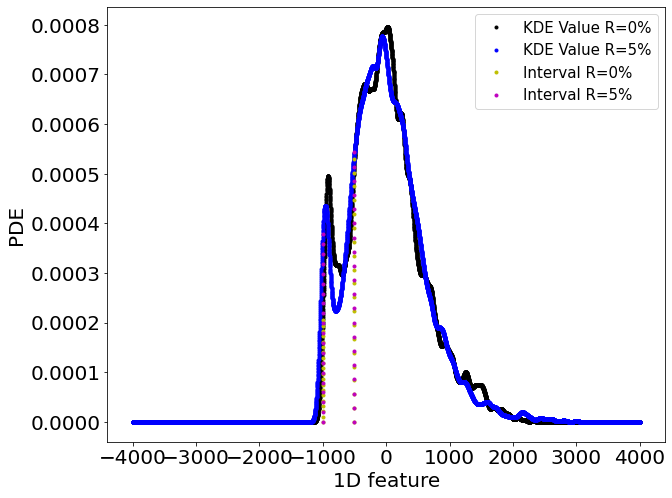

In [28]:
"""可视化所选取的区间"""
plt.figure(figsize = (10, 8))  # 设置画布大小
plt.plot(xplot, np.exp(dens_0), marker='.', linewidth=1e-10, c="k", label='KDE Value R=0%')
plt.plot(xplot, np.exp(dens_5f), marker='.', linewidth=1e-10, c="b", label='KDE Value R=5%')

px_0 = [-1000] * 20 + [-500] * 20
py_0 = list(np.linspace(0, np.exp(kde_0.score_samples([[-1000]])[0]), 20)) + list(np.linspace(0, np.exp(kde_0.score_samples([[-500]])[0]), 20))

px_5f = [-1000] * 20 + [-500] * 20
py_5f = list(np.linspace(0, np.exp(kde_5f.score_samples([[-1000]])[0]), 20)) + list(np.linspace(0, np.exp(kde_5f.score_samples([[-500]])[0]), 20))

plt.plot(px_0, py_0, marker='.', linewidth=1e-5, c="y", label='Interval R=0%')
plt.plot(px_5f, py_5f, marker='.', linewidth=1e-5, c="m", label='Interval R=5%')

plt.tick_params(labelsize = 20)  # 设置坐标刻度值的大小
font = {'size': 20}  # 设置横纵坐标的名称以及对应字体格式、大小
plt.xlabel('1D feature', font)
plt.ylabel('PDE', font)
plt.legend(fontsize = 15)  # 显示图例,设置图例字体大小
plt.show()

In [29]:
"""R=5%时新添的[-1000, -500]中样本对应的样本类别统计"""
ind_int_r5f = np.array([i for (i,x) in enumerate(res_5f[ind_r5m].flatten().tolist()) if -1000 <= x < -500])
ind_int_r5fo = np.array(ind)[ind_int_r5f]
num_int_r5f = ind_int_r5fo.shape[0]
label_int_r5f = y2_train[ind_int_r5fo]
num_int_r5f0 = label_int_r5f.tolist().count(0)
num_int_r5f1 = label_int_r5f.tolist().count(1)
num_int_r5f2 = label_int_r5f.tolist().count(2)
num_int_r5f3 = label_int_r5f.tolist().count(3)
num_int_r5f4 = label_int_r5f.tolist().count(4)
num_int_r5f5 = label_int_r5f.tolist().count(5)
num_int_r5f6 = label_int_r5f.tolist().count(6)
num_int_r5f7 = label_int_r5f.tolist().count(7)
num_int_r5f8 = label_int_r5f.tolist().count(8)
num_int_r5f9 = label_int_r5f.tolist().count(9)

### 实验1-2-2 ：N = 5000，替换MNIST vs 替换Fashion-MNIST
a) R=5%，可视化替换MNIST与替换Fashion-MNIST的对比

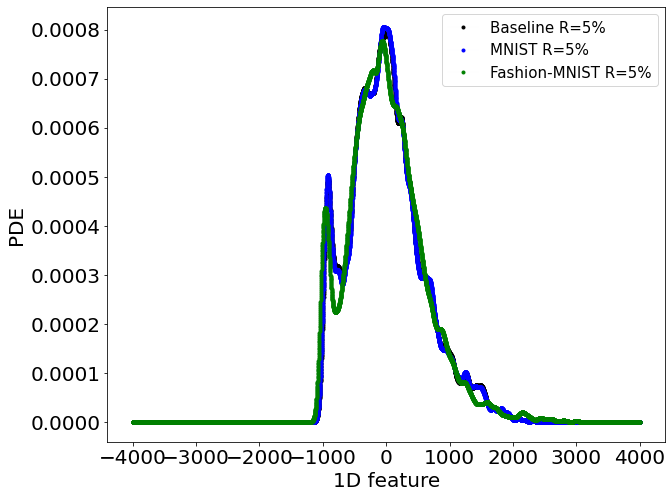

In [30]:
plt.figure(figsize = (10, 8))  # 设置画布大小
plt.plot(xplot, np.exp(dens_0), marker='.', linewidth=0.01, c="k", label='Baseline R=5%')
plt.plot(xplot, np.exp(dens_5m), marker='.', linewidth=0.01, c="b", label='MNIST R=5%')
plt.plot(xplot, np.exp(dens_5f), marker='.', linewidth=0.01, c="g", label='Fashion-MNIST R=5%')
plt.tick_params(labelsize = 20)  # 设置坐标刻度值的大小
font = {'size': 20}  # 设置横纵坐标的名称以及对应字体格式、大小
plt.xlabel('1D feature', font)
plt.ylabel('PDE', font)
plt.legend(fontsize = 15)  # 显示图例,设置图例字体大小
plt.show()

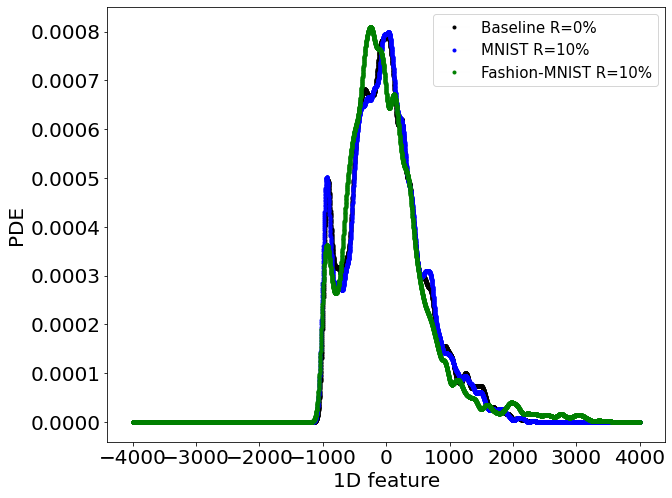

In [31]:
plt.figure(figsize = (10, 8))  # 设置画布大小
plt.plot(xplot, np.exp(dens_0), marker='.', linewidth=0.01, c="k", label='Baseline R=0%')
plt.plot(xplot, np.exp(dens_10m), marker='.', linewidth=0.01, c="b", label='MNIST R=10%')
plt.plot(xplot, np.exp(dens_10f), marker='.', linewidth=0.01, c="g", label='Fashion-MNIST R=10%')
plt.tick_params(labelsize = 20)  # 设置坐标刻度值的大小
font = {'size': 20}  # 设置横纵坐标的名称以及对应字体格式、大小
plt.xlabel('1D feature', font)
plt.ylabel('PDE', font)
plt.legend(fontsize = 15)  # 显示图例,设置图例字体大小
plt.show()

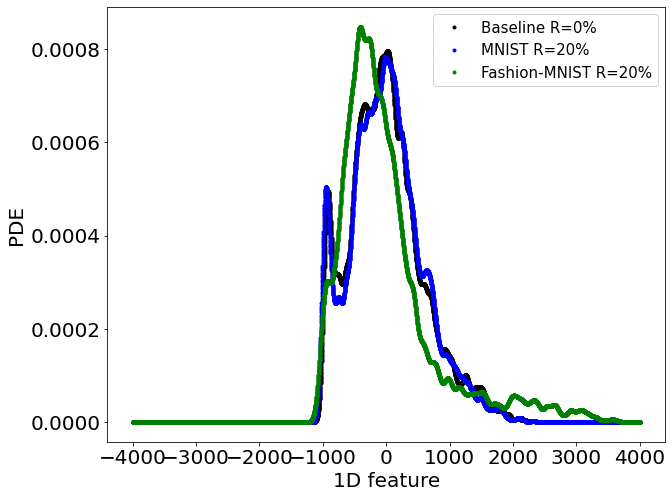

In [32]:
plt.figure(figsize = (10, 8))  # 设置画布大小
plt.plot(xplot, np.exp(dens_0), marker='.', linewidth=0.01, c="k", label='Baseline R=0%')
plt.plot(xplot, np.exp(dens_20m), marker='.', linewidth=0.01, c="b", label='MNIST R=20%')
plt.plot(xplot, np.exp(dens_20f), marker='.', linewidth=0.01, c="g", label='Fashion-MNIST R=20%')
plt.tick_params(labelsize = 20)  # 设置坐标刻度值的大小
font = {'size': 20}  # 设置横纵坐标的名称以及对应字体格式、大小
plt.xlabel('1D feature', font)
plt.ylabel('PDE', font)
plt.legend(fontsize = 15)  # 显示图例,设置图例字体大小
plt.show()

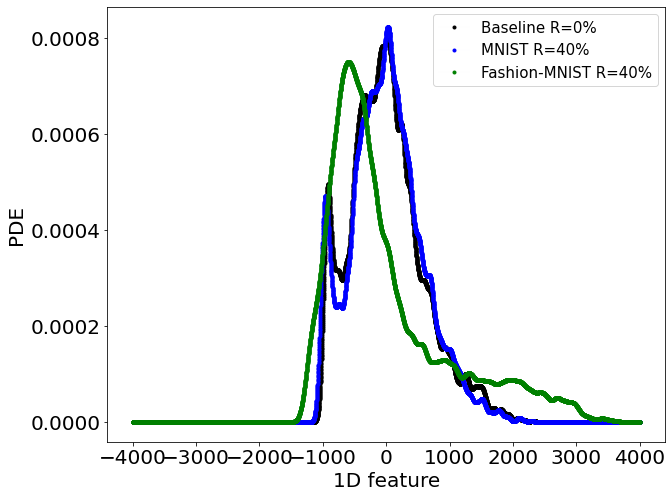

In [33]:
plt.figure(figsize = (10, 8))  # 设置画布大小
plt.plot(xplot, np.exp(dens_0), marker='.', linewidth=0.01, c="k", label='Baseline R=0%')
plt.plot(xplot, np.exp(dens_40m), marker='.', linewidth=0.01, c="b", label='MNIST R=40%')
plt.plot(xplot, np.exp(dens_40f), marker='.', linewidth=0.01, c="g", label='Fashion-MNIST R=40%')
plt.tick_params(labelsize = 20)  # 设置坐标刻度值的大小
font = {'size': 20}  # 设置横纵坐标的名称以及对应字体格式、大小
plt.xlabel('1D feature', font)
plt.ylabel('PDE', font)
plt.legend(fontsize = 15)  # 显示图例,设置图例字体大小
plt.show()

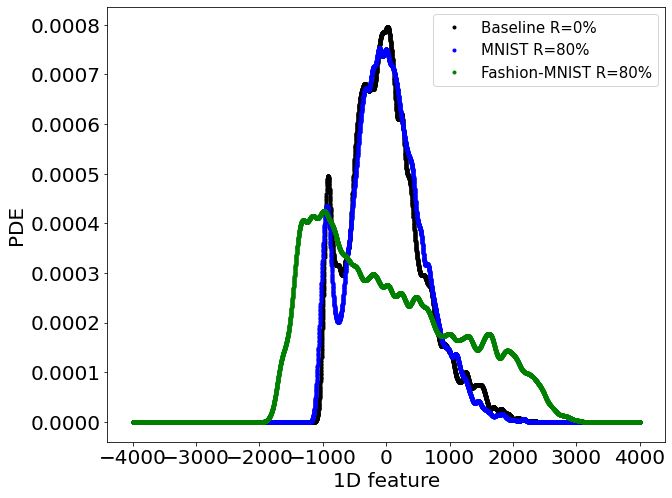

In [34]:
plt.figure(figsize = (10, 8))  # 设置画布大小
plt.plot(xplot, np.exp(dens_0), marker='.', linewidth=0.01, c="k", label='Baseline R=0%')
plt.plot(xplot, np.exp(dens_80m), marker='.', linewidth=0.01, c="b", label='MNIST R=80%')
plt.plot(xplot, np.exp(dens_80f), marker='.', linewidth=0.01, c="g", label='Fashion-MNIST R=80%')
plt.tick_params(labelsize = 20)  # 设置坐标刻度值的大小
font = {'size': 20}  # 设置横纵坐标的名称以及对应字体格式、大小
plt.xlabel('1D feature', font)
plt.ylabel('PDE', font)
plt.legend(fontsize = 15)  # 显示图例,设置图例字体大小
plt.show()

RQ：输出1-1-1 b与1-2-1 b参数

In [35]:
print(num_int_r5, num_int_r5m0, num_int_r5m1, num_int_r5m2, num_int_r5m3, num_int_r5m4, num_int_r5m5, num_int_r5m6, num_int_r5m7, num_int_r5m8, num_int_r5m9)

51 5 4 4 1 8 2 8 10 3 6


In [36]:
print(num_int_r5mt, num_int_r5mt0, num_int_r5mt1, num_int_r5mt2, num_int_r5mt3, num_int_r5mt4, num_int_r5mt5, num_int_r5mt6, num_int_r5mt7, num_int_r5mt8, num_int_r5mt9)

49 3 8 4 2 7 4 10 2 6 3


In [37]:
print(num_int_r5f, num_int_r5f0, num_int_r5f1, num_int_r5f2, num_int_r5f3, num_int_r5f4, num_int_r5f5, num_int_r5f6, num_int_r5f7, num_int_r5f8, num_int_r5f9)

2 0 0 0 0 2 0 0 0 0 0
